# Visualizations 

This notebook provides following visualizations

* maps
* heatmaps
* Correlation maps

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle
import pandas as pd
import seaborn as sns
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

In [2]:
#Open file
with open('Clean_Final_Project.pickle', 'rb') as data:
        dataset = pickle.load(data)

In [3]:
orginal_dataset = pd.read_csv('kc_house_data.csv')

In [4]:
#Set orginal lat and long
dataset['lat']=orginal_dataset['lat']
dataset['long'] =orginal_dataset['long']

In [5]:
dataset

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,condition,sqft_above,yr_built,zipcode,lat,long,Monthly_Mortage,Possible_Rent,Net_Profit
0,221900,3,1,1180,5650,1,3,1180,1955,98178,47.5112,-122.257,1008.86,2750.0,1741.14
1,538000,3,2,2570,7242,2,3,2170,1951,98125,47.7210,-122.319,2445.99,2750.0,304.01
2,180000,2,1,770,10000,1,3,770,1933,98028,47.7379,-122.233,818.36,1500.0,681.64
3,604000,4,3,1960,5000,1,5,1050,1965,98136,47.5208,-122.393,2746.06,3250.0,503.94
4,510000,3,2,1680,8080,1,3,1680,1987,98074,47.6168,-122.045,2318.69,2750.0,431.31
5,1225000,4,4,5420,101930,1,3,3890,2001,98053,47.6561,-122.005,5569.41,3250.0,-2319.41
6,257500,3,2,1715,6819,2,3,1715,1995,98003,47.3097,-122.327,1170.71,2750.0,1579.29
7,291850,3,1,1060,9711,1,3,1060,1963,98198,47.4095,-122.315,1326.88,2750.0,1423.12
8,229500,3,1,1780,7470,1,3,1050,1960,98146,47.5123,-122.337,1043.41,2750.0,1706.59
9,323000,3,2,1890,6560,2,3,1890,2003,98038,47.3684,-122.031,1468.50,2750.0,1281.50


In [6]:
#Seattle Map
seattle_coordinates = folium.Map([47.5112,-122.257], zoom_start=11)
seattle_coordinates

In [7]:
# define a function to draw a basemap easily
def generateBaseMap(default_location=[47.5112, -122.257], default_zoom_start=9.4):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map
basemap = generateBaseMap()
# add carton position map
folium.TileLayer('cartodbpositron').add_to(basemap)
s=folium.FeatureGroup(name='icon').add_to(basemap)

# add heatmap
HeatMap(data=dataset[['lat','long','bedrooms']].groupby(['lat','long']).sum().reset_index().values.tolist(),
        radius=8,max_zoom=13,name='Heat Map').add_to(basemap)
folium.LayerControl(collapsed=False).add_to(basemap)
basemap

In [8]:
#Adding price to the 
for each in dataset.iterrows():
    folium.Marker([each[1]['lat'],each[1]['long']],
                      popup=(each[1]['price'],each[1]['bedrooms'],each[1]['bathrooms'],each[1]['Net_Profit']))

In [9]:
#Adding infromation on the map
some_map = folium.Map(location=[dataset['lat'].mean(), 
 dataset['long'].mean()], 
 zoom_start=4)
mc = MarkerCluster()
#creating a Marker for each point in df_sample. Each point will get a popup with their zip
for row in dataset.itertuples():
    mc.add_child(folium.Marker(location=[row.lat,  row.long],
                 popup=["Price: $" , row.price,"Bedrooms:",row.bedrooms,"Bathrooms:",row.bedrooms,"Profit: $",row.Net_Profit]))
 
some_map.add_child(mc)
some_map

In [34]:
some_map.save('index.html')

In [11]:
#Create a HeatMap

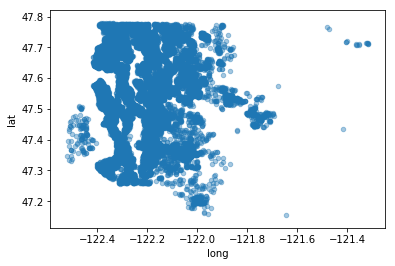

In [12]:
#passing map coordinatinates
dataset.plot(kind= "scatter",x= 'long', y='lat',alpha=0.4)
plt.show()

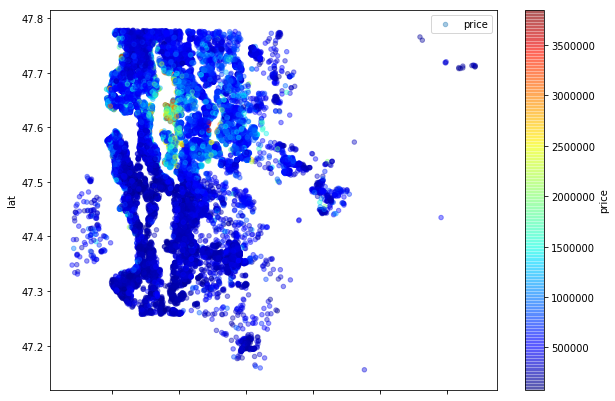

In [22]:
#Plotting prices
dataset.plot(kind= "scatter",x= 'long', y='lat',
            label = 'price',
            c= "price", cmap= plt.get_cmap("jet"),
            colorbar=True, alpha = 0.4, figsize=(10,7),)
plt.legend()
plt.show()

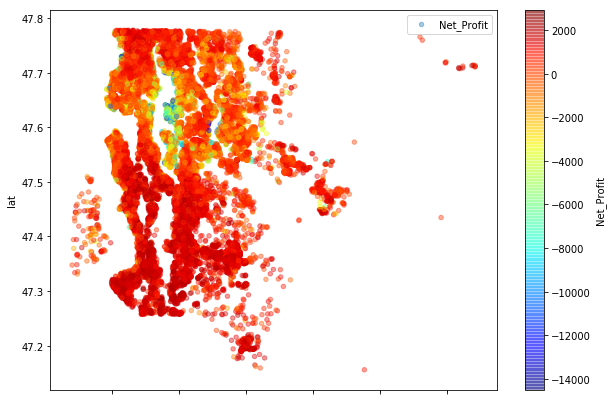

In [21]:
#Plotting price
dataset.plot(kind= "scatter",x= 'long', y='lat',
            label = 'Net_Profit',
            c= "Net_Profit", cmap= plt.get_cmap("jet"),
            colorbar=True, alpha = 0.4, figsize=(10,7),)
plt.legend()
plt.show()

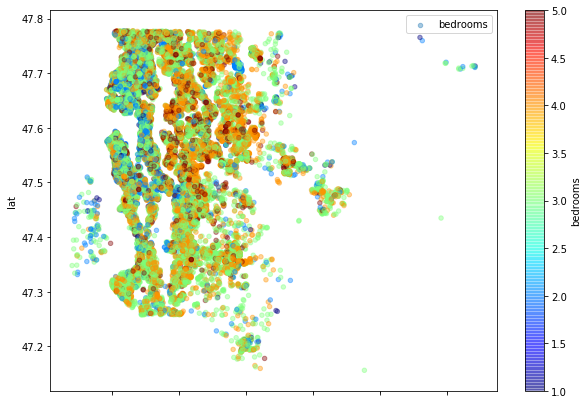

In [20]:
#Plotting price
dataset.plot(kind= "scatter",x= 'long', y='lat',
            label = 'bedrooms',
            c= "bedrooms", cmap= plt.get_cmap("jet"),
            colorbar=True, alpha = 0.4, figsize=(10,7),)
plt.legend()
plt.show()

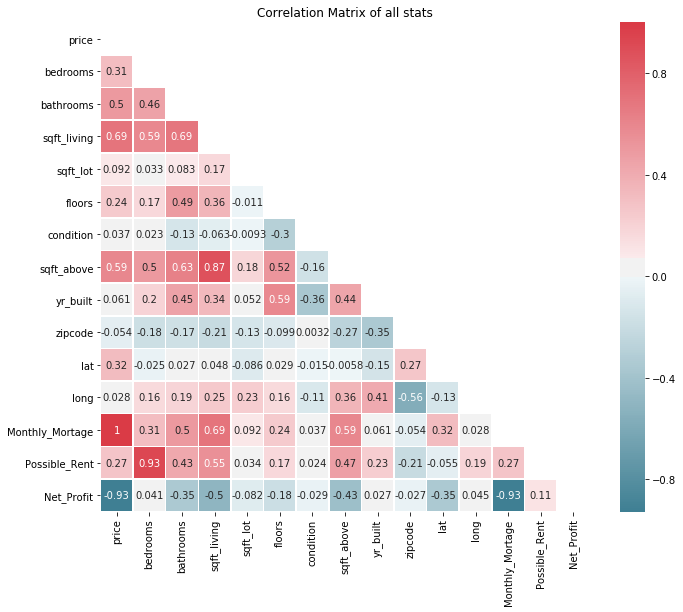

In [17]:

# Compute the correlation matrix
data = dataset[['price','bedrooms','bathrooms','sqft_living','sqft_lot','floors','condition','sqft_above','yr_built','zipcode','lat','long','Monthly_Mortage','Possible_Rent']]

corr = dataset.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, 
            square=True, linewidths=.5, annot=True, cmap=cmap)
plt.yticks(rotation=0)
plt.title('Correlation Matrix of all stats')
plt.show()

Text(0, 0.5, 'floors')

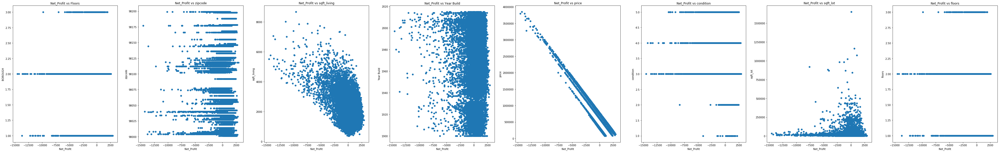

In [56]:
plt.figure(figsize=(70,10))

plt.subplot(1,8,1)
plt.scatter(dataset["Net_Profit"], dataset["floors"])
plt.title("Net_Profit vs Floors")
plt.xlabel('Net_Profit')
plt.ylabel('BOROUGH')

plt.subplot(1,8,2)
plt.scatter(dataset["Net_Profit"], dataset["zipcode"])
plt.title("Net_Profit vs zipcode")
plt.xlabel('Net_Profit')
plt.ylabel('zipcode')

plt.subplot(1,8,3)
plt.scatter(dataset["Net_Profit"], dataset["sqft_living"])
plt.title("Net_Profit vs sqft_living")
plt.xlabel('Net_Profit')
plt.ylabel('sqft_living')

plt.subplot(1,8,4)
plt.scatter(dataset["Net_Profit"], dataset["yr_built"])
plt.title("Net_Profit vs Year Build")
plt.xlabel('Net_Profit')
plt.ylabel('Year Build')

plt.subplot(1,8,5)
plt.scatter(dataset["Net_Profit"], dataset["price"])
plt.title("Net_Profit vs price")
plt.xlabel('Net_Profit')
plt.ylabel('price')


plt.subplot(1,8,6)
plt.scatter(dataset["Net_Profit"], dataset["condition"])
plt.title("Net_Profit vs condition")
plt.xlabel('Net_Profit')
plt.ylabel('condition')


plt.subplot(1,8,7)
plt.scatter(dataset["Net_Profit"], dataset["sqft_lot"])
plt.title("Net_Profit vs sqft_lot")
plt.xlabel('Net_Profit')
plt.ylabel('sqft_lot')




plt.subplot(1,8,8)
plt.scatter(dataset["Net_Profit"], dataset["floors"])
plt.title("Net_Profit vs floors")
plt.xlabel('Net_Profit')
plt.ylabel('floors')




Text(0.5, 1.0, 'zipcode')

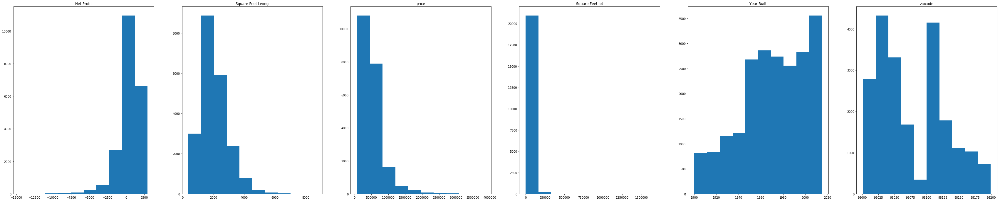

In [59]:
plt.figure(figsize=(60,40))


plt.subplot(3,6,1)
plt.hist(dataset['Net_Profit'])
plt.title('Net Profit')

plt.subplot(3,6,2)
plt.hist(dataset['sqft_living'])
plt.title('Square Feet Living')

plt.subplot(3,6,3)
plt.hist(dataset['price'])
plt.title('price')

plt.subplot(3,6,4)
plt.hist(dataset['sqft_lot'])
plt.title('Square Feet lot')

plt.subplot(3,6,5)
plt.hist(dataset['yr_built'])
plt.title('Year Built')

plt.subplot(3,6,6)
plt.hist(dataset['zipcode'])
# plt.title('zipcode')

In [70]:
# This function is to find Bivariate analysis

def data_function(data1,data2):

# Standardizing variables by subtracting the mean and dividing by the standard
# deviation. Now both variables are on the same scale.
    dataset['Net_Profit'] = (dataset['Net_Profit'] - dataset['Net_Profit'].mean()) / dataset['Net_Profit'].std()
    dataset[data1] = (dataset[data1] - dataset[data1].mean()) / dataset[data1].std()

    t = sns.regplot(
    data1,
    'Net_Profit',
    dataset,
    x_jitter=.49,
    y_jitter=.49,
    fit_reg=False
    )
    t.axhline(0, color='k', linestyle='-', linewidth=2)
    t.axvline(0, color='k', linestyle='-', linewidth=2)
    t.axes.set_title(data2)

    sns.regplot(data1,'Net_Profit',
            dataset, 
            scatter=False, 
            color="red")

    plt.show()
    
    

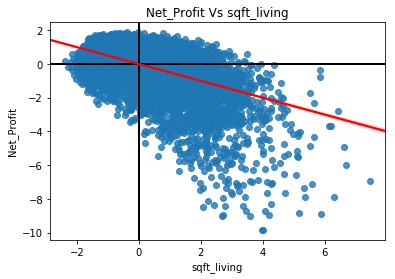

In [71]:
data_function('sqft_living',"Net_Profit Vs sqft_living")

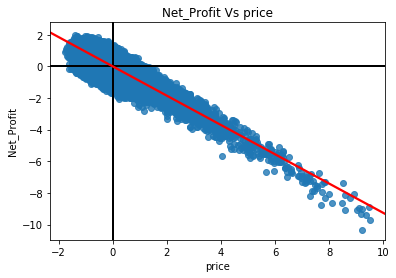

In [72]:
data_function('price',"Net_Profit Vs price")

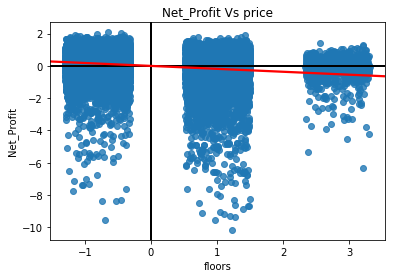

In [74]:
data_function('floors',"Net_Profit Vs price")

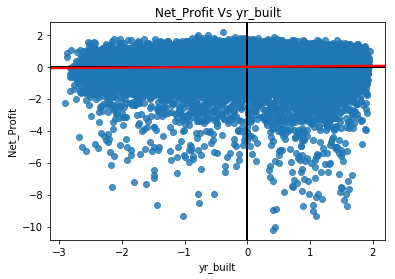

In [75]:
data_function('yr_built',"Net_Profit Vs yr_built")

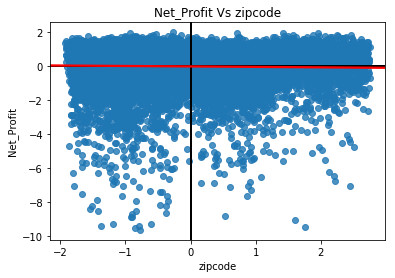

In [76]:
data_function('zipcode',"Net_Profit Vs zipcode")

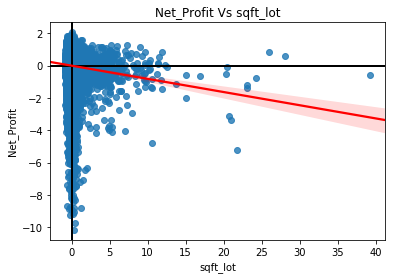

In [78]:
data_function('sqft_lot',"Net_Profit Vs sqft_lot")

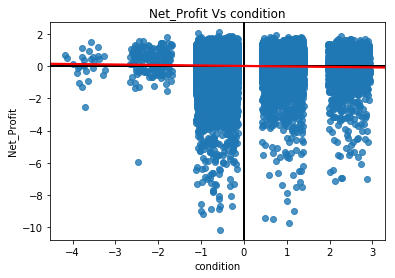

In [79]:
data_function('condition',"Net_Profit Vs condition")

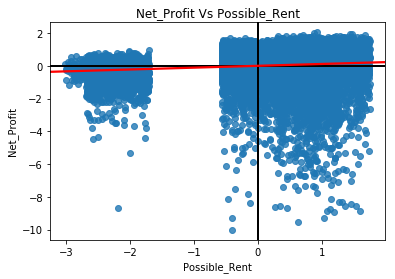

In [81]:
data_function('Possible_Rent',"Net_Profit Vs Possible_Rent")

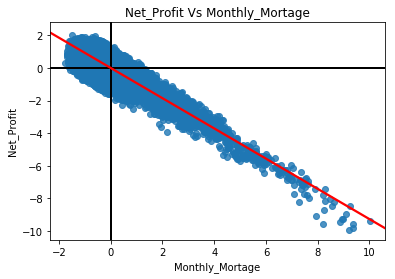

In [83]:
data_function('Monthly_Mortage',"Net_Profit Vs Monthly_Mortage")

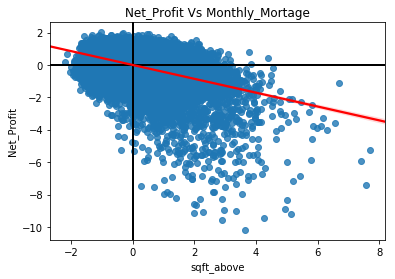

In [86]:
data_function('sqft_above',"Net_Profit Vs sqft_above")

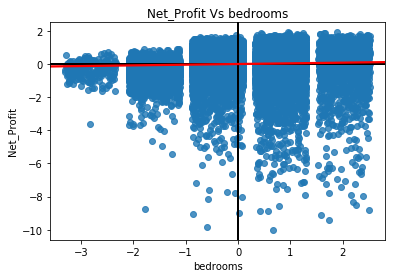

In [88]:
data_function('bedrooms',"Net_Profit Vs bedrooms")

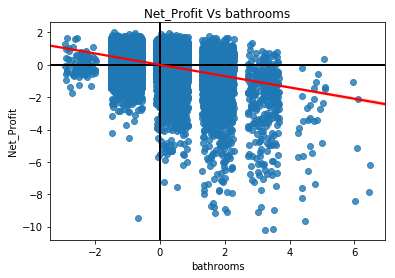

In [89]:
data_function('bathrooms',"Net_Profit Vs bathrooms")

In [90]:
dataset

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,condition,sqft_above,yr_built,zipcode,lat,long,Monthly_Mortage,Possible_Rent,Net_Profit
0,-0.910698,-0.392690,-1.032247,-0.991458,-0.226669,-0.805022,-0.629165,-0.733655,-0.549724,1.870474,47.5112,-122.257,-0.910696,-0.076586,0.909866
1,0.013431,-0.392690,0.377575,0.579919,-0.188276,1.007535,-0.629165,0.488784,-0.686054,0.879892,47.7210,-122.319,0.013430,-0.076586,-0.043853
2,-1.033194,-1.600710,-1.032247,-1.454957,-0.121764,-0.805022,-0.629165,-1.239918,-1.299535,-0.933060,47.7379,-122.233,-1.033195,-2.194789,0.206753
3,0.206384,0.815330,1.787397,-0.109678,-0.242344,-0.805022,2.447121,-0.894177,-0.208901,1.085485,47.5208,-122.393,0.206386,0.770696,0.088827
4,-0.068428,-0.392690,0.377575,-0.426214,-0.168066,-0.805022,-0.629165,-0.116261,0.540909,-0.073309,47.6168,-122.045,-0.068429,-0.076586,0.040627
5,2.021898,0.815330,3.197219,3.801807,2.095230,-0.805022,-0.629165,2.612618,1.018062,-0.465804,47.6561,-122.005,2.021901,0.770696,-1.784826
6,-0.806620,-0.392690,0.377575,-0.386647,-0.198477,1.007535,-0.629165,-0.073044,0.813568,-1.400315,47.3097,-122.327,-0.806621,-0.076586,0.802458
7,-0.706196,-0.392690,-1.032247,-1.127116,-0.128733,-0.805022,-0.629165,-0.881829,-0.277066,2.244279,47.4095,-122.315,-0.706198,-0.076586,0.698820
8,-0.888479,-0.392690,-1.032247,-0.313166,-0.182777,-0.805022,-0.629165,-0.894177,-0.379313,1.272387,47.5123,-122.337,-0.888479,-0.076586,0.886938
9,-0.615128,-0.392690,0.377575,-0.188812,-0.204723,1.007535,-0.629165,0.143044,1.086226,-0.746157,47.3684,-122.031,-0.615131,-0.076586,0.604837


In [91]:
#Save as the final dataset
final_dataset = dataset

In [92]:
#Saving the file

import pickle


with open('Clean_final_dataset.pickle', 'wb') as output:
    pickle.dump(final_dataset, output)